# Financial Models
*Mostly Monte Carlo Methods*
<hr>

## Table of Contents
1. [Investing 101](#Investing-101)
2. [Some Math](#Some-Math)
3. [More Monte Carlo Simulations](#More-Monte-Carlo-Simulations)

<hr>

Lucas Durand, DeepGreen Notebook Lead

## Some Dependencies

In [10]:
import numpy as np #arrays and math stuff
# New plots!
import plotly.express as px
import cufflinks as cf
cf.go_offline()

import requests
import matplotlib.pyplot as plt #for plotting (the old way)
import seaborn #prettifies the matplotlib library

import sobol_seq #contains Sobols Sequence sampling
import time #why not
import pandas as pd # PANDAS!
import scipy
import math
from colour import Color

# Investing 101

1. [Savings Accounts](#Savings-Accounts)
2. [Stocks, Bonds, ETFs](#Stocks,-Bonds,-ETFs)
    1. [Toy Model](#Toy-Model)
3. [Options](#Options)


## Savings Accounts

How do savings accounts work? 
- Put money in with the intention of aggregating funds for a guaranteed return. 
- Presumably, the bank takes that money and uses it for another endeavour which nets a higher return.
    - e.g. pay 0.05% interest to savings account, loan money as mortgage at 5%

How much money can we make with savings accounts?? 

### Future Value

In the case of a **fixed rate of interest**, we have a closed-form solution for what the **future value** of money is worth over time.

> $FV = C (1+r)^n$, given a present cash flow $C$, rate of interest $r$ and number of compoundings $n$. 

This also generalizes into a continuous form:
> $FV = C e^{rt}$, for a cashflow at time $t$
 
So we can plot this, use it in equations, etc. in order to inform our decisions.



#### Three TD Savings Strategies

In [11]:
t_end = 5 #calculate until
t_f = 5 #expiry time

t = np.linspace(0,t_end,261*t_end)
r_tdeveryday = 0.05 * 0.01 # Everyday Savings Account interest rate
r_tdhighint = 0.5* 0.01 # High Interest Savings Account interest rate
r_tdgic = 1.0 * 0.01 # Special GIC interest rate
c= 1000 #starting with $1000

def fv(t,r,c=c): #future value equation
    return c*np.exp(r*t)

lines = [{'label':'Everyday Savings Account','vals':fv(t,r=r_tdeveryday),'y_int':fv(t_f,r=r_tdeveryday)},\
        {'label':'High Interest Savings Accounts','vals':fv(t,r=r_tdhighint),'y_int':fv(t_f,r=r_tdhighint)},\
         {'label':'Special Offer GIC','vals':fv(t,r=r_tdgic),'y_int':fv(t_f,r=r_tdgic)}]


low_interest = pd.DataFrame({x['label']:x['vals'] for x in lines})

Safe Investments

In [12]:
low_interest.iplot(title='Five Years of Savings')

## Stocks, Bonds, ETFs

Stocks
- Buy a share of a company!
- Value tied to perceived value of company
    - e.g. Alice **bids** 9 for XYZ and Bob **asks** 11 
    - $\implies$ XYZ $\approx$ 10
- A stock is a winner if it outperforms our savings account (or some index)

Bonds
- Loan money to a stranger!
    - Government or Corporation (*but really what's the difference?*)
- Pays back initial investment at expiry time, and pays **coupons** at regular intervals
- Coupons can be **variable rate** (tied to an overnight lending rate like LIBOR or fixed rate)
- We won't talk about these any more


ETFs
- Throw your money at a pile of money!
- Essentially a *stock of stocks*, an instrument bought and sold on a market that tracks an index/indicator
- e.g. S&P 500 [^GSPC], TSX Composite [^TSX]

How can we predict the future value of Stocks & ETFs?

### Toy Model

- Every day the instrument price **randomly** changes
- Changes lie on a **log normal distribution** (strictly positive prices)
- The distribution has mean **$\mu$** and standard deviation **$\sigma$** equal to the historical mean and volatility of the stock.

Load Historical Data

In [13]:
alphavantage = 'ILOGGGJYAP5W1S3V'

In [14]:
def get_history(symbol):
    r = requests.get(f'https://www.alphavantage.co/query?function=TIME_SERIES_DAILY&symbol={symbol}&outputsize=full&apikey={alphavantage}')
    df = pd.DataFrame(r.json()['Time Series (Daily)'])
    df = df.T
    df = df[['4. close']].rename(columns={'4. close':'historical'})
    df.historical = pd.to_numeric(df.historical)
    # missing data
    df = df[df.historical > 0].sort_index()
    df['delta'] = df.pct_change().iloc[1:] + 1
    return df

In [15]:
#S&P 500
history = get_history('^GSPC')

In [16]:
def slice_history(history, start=None, end=None):
    sliced = history[start:end]
    mean = sliced.delta.mean()
    vol = sliced.delta.std()
    return sliced.copy(), mean, vol

In [17]:
last_year, mean, vol = slice_history(history, '2018-01-01')

In [18]:
def gen_runs(N,mean,vol,history,extend=0,c=1000):
    T = len(history) + extend
    more_dates = pd.bdate_range(history.index[-1], periods=extend+1).tolist()[1:] if extend else []
    index = history.index.tolist() + more_dates
    cumr = np.empty((N,T))
    for i in range(N): # this isn't needed, we can do this all in one np operation
        r = np.log(np.random.lognormal(mean,vol, T-1))
        r = np.insert(r,0,c)
        cumr[i] = np.cumprod(r)
    df = pd.DataFrame(cumr).T
    df.index = index
    return df

In [19]:
def plot_runs(N, mean, vol, history, extend=0, title=None, c=None, plot=True, quantiles=False):
    c = c if c else history.iloc[0].historical
    
    cumr = gen_runs(N, mean, vol, history, c=c, extend=extend)

    runs = pd.concat([history,cumr], axis=1, sort=False)

    runs.drop(columns='delta',inplace=True)
    runs['median'] = runs.iloc[:,1:].median(axis=1)
    
    if quantiles or N > 100:
        binned_runs = cumr.quantile(q=[0.01,0.05,0.25,0.75,0.95,0.99], axis = 1).T
        runs = runs[['historical','median']].join(binned_runs)
    
    runs.columns = runs.columns.astype(str)
    runs = runs.reindex(sorted(runs.columns,reverse=False), axis=1)
    
    if not plot:
        return runs
    fig = runs.figure(title=title, width = [1]*(len(runs.columns)-2) + [3,3], opacity=0.1)
    fig.data[-1].line.color = 'red'
    fig.data[-2].line.color = 'black'
    if quantiles or N > 100:
        for line in fig.data[:-2]:
            line.line.color = 'green'
            line.fill='tonexty'
            line.opacity=0.5
        fig.data[0].fill=None
    return fig

#### A Single, Solitary Run

In [20]:
plot_runs(1, mean, vol, last_year, title='A Single Solitary Run')

This is one possible future. But what other possible futures are there?

#### Many Possible Paths

In [21]:
plot_runs(25, mean, vol, last_year, title='A Few Possible Futures')

We just did a Monte Carlo!

#### Percentile Binning

In [22]:
plot_runs(50, mean, vol, last_year, title='A Few Possible Futures', quantiles=True)

## Options


A type of derivative that allows the holder the right to buy **(call)** or sell **(put)** the underlying asset at (or before) a future date (the **expiry**) at a predetermined price (the **strike price**)

The value of an option is equal to the difference between the strike price and the value of the underlying.

> $Put = \max(\text{Strike} - V(t),0)$

> $Call = \max(V(t)- \text{Strike},0)$


# Some Math

1. Law of Large Numbers
2. Central Limit Theorem
1. Random Numbers

### Law of Large Numbers

> Performing the same experiment many times, the average of the outcomes approaches the expected value

### Central Limit Theorem

> The average of many independent variables tends toward a normal distribution

# Random Numbers
*What are they?*

Mathematically, $n \subset [0,1]$ is a sequence of **random numbers** iff:
1. $P(n_i) = P(n_j) \quad \forall i,j \qquad$ **Uniform Distribution**
2. $P(n_i) = P(n_i|n_{i-1}) \qquad$ **Numbers are Independent**

## Why are they important?

Two big uses for random numbers are:

* Stochastic Approximations (e.g. Monte Carlo Methods!)
* Cryptography (e.g. Public/Private Key Generation)
* Winning at Rock, Paper, Scissors

## How do we make them?
Not very well.

* Slowly, using random physical phenomena 
    * e.g. Photon phase shifts, thermal CPU noise, ...
    * These are "truly" random (depending who you ask)

* Quickly, with pseudo-random number generation:
    * $X_{n+1} = (a X_n + b)\ \text{mod} \ m $, where $a,b,m$ are large seed values
    * These (like those used in RAS keys) are fully deterministic with the right knowledge (i.e. #2 is broken)

In [23]:
N = 100000
points = [{'row':i,'col':j, 'x':np.random.random(), 'y':np.random.random(), 'color':point } for i in range(4) for j in range(4) for point in range(int(N/16))]
random = pd.DataFrame(points)

In [24]:
px.scatter(random.sample(frac=0.1), x='x', y='y', color='color', title="A Few Random Samples")

Random Points in 2D

- Good coverage with lots of points
- Some localized gaps
- Colour distribution is a good indicator that points are separated in time

In [25]:
px.scatter(random.sample(frac=0.01), x='x', y='y', facet_row='row', facet_col='col', color='color', title="Many Small Random Samples")

Many Small Random Samples
- Clumping is noticable
- Space not well filled without large number of points

# Sobol Sequence

* Sequence of numbers which better "fill" the parameter space
* Defined for *fastest* convergence
* Fall apart in large-dimensioned problems (we don't mind)

What could that mean?

Let's see!

In [26]:
sobols = pd.DataFrame([(x,y) for x,y in sobol_seq.i4_sobol_generate(2, len(random))])
sobols[:5]

,0,1
0,0.500,0.500
1,0.750,0.250
2,0.250,0.750
3,0.375,0.375
4,0.875,0.875


### Huh?

... let's see it plotted

In [27]:
sobols = sobols.rename(columns={0:'x',1:'y'})
sobol_fig = px.scatter(sobols.iloc[:1000].reset_index(), x='x', y='y', color='index', title='Sobol Random Points')
sobol_fig

In [28]:
# create timeseries frames to animate points
def generate_frames(df, n_frames=100):
    steps = [df.iloc[:i] for i in range(min(n_frames,len(df)))]
    for i, step in enumerate(steps):
        step['frame'] = i
    return pd.concat(steps)

steps = generate_frames(sobols)
steps['size'] = 5

In [29]:
px.scatter(steps.reset_index(), title='Sobol Point Order Matters', x='x', y='y', size='size', animation_frame='frame', color='index', range_x=[0,1], range_y=[0,1])

# More Monte Carlo Simulations

1. [Estimate $\pi$](#Estimate-Pi)
2. [Gamble Winningly](#Gamble-Winningly)
3. [An Argument for Public Transit](#Relive-Traffic-Nightmares)
2. [Toy Model Again](#Toy-Model-Again)


## What is it?

A Monte Carlo simulation is a numerical method that allows for the accountability of risk in quantitative analysis. By replacing fixed variables with probability distributions and randomly sampling possible outcomes, we can assign probabilities to scenarios and develop a risk profile, all while solving analytically intractable problems. 

We use them for:

   * Optimization
   * Numerical integration
   * Sampling probability distributions
    


## Estimate Pi

#### What we're doing:
1. Sample $n$ points in a 1x1 square
2. Count any points ($n_{in}$) that fall within the area of a circle,$x^2 + y^2 \leq r^2$
3. We expect that the probability of a point being in the circle, $P(\text{circle})$, to be proportional to its area, $A_\text{circle}$
4. Sample enough points that the estimation converges to some value


#### The equation:
$\frac{P(\text{Circle})}{P(\text{Square})} \sim \frac{A_\text{circ}}{A_\text{square}} = \frac{\pi r^2}{(2r)^2}  \\ 
\lim_{n\rightarrow \infty} \implies \pi \sim 4\frac{n_{in}}{n} $



![circle](https://static1.squarespace.com/static/54e50c15e4b058fc6806d068/t/54f63a69e4b02d96d056f5c5/1460531331862/basic-circle.png?format=500w)

In [30]:
def condition(x,y,r=1/2):
    return (x-r)**2 + (y-r)**2 <= r**2  #circle inscribed in square
    #return x <= r #square sliced in two

In [31]:
random['in'] = condition(random['x'], random['y'])
sobols['in'] = condition(sobols['x'], sobols['y'])

random['pi'] = 4 * random['in'].cumsum() / (random.index + 1)
sobols['pi'] = 4 * sobols['in'].cumsum() / (sobols.index + 1)

random['simulation'] = 'random'
sobols['simulation'] = 'sobol'

pi_simulation = pd.concat([random, sobols], sort=False)

In [32]:
pi_fig = px.line(pi_simulation.reset_index(), title='Approximation of Pi', x='index', y='pi', color='simulation', log_x=True)

In [33]:
import plotly.graph_objects as go

pi_line = go.layout.Shape(
    type="line",
    x0=np.pi,
    y0=np.pi,
    x1=len(random),
    y1=np.pi,
    line=dict(
        color="rgba(0,0,0,0.5)",
        width=2,
        dash="dashdot"
    ),
),

In [34]:
pi_fig.update_layout(shapes = pi_line)

## Gamble Winningly

The Game
> Flip a coin 10 times, if you get 3 heads, you win $1,000,000

The Question
> How much would you pay to play this game?

The Answer

> The probability for $k$ heads in $n$ flips of a coin with probability $p$, we can use the **binomial equation** ...

> $P(k) = {n\choose{k}}p^k (1−p)^{n−k}$

> with expected winnings, $E(3) = V(3) P(3)$

In [48]:
E = 10**6 * np.math.factorial(10)/(np.math.factorial(3)*np.math.factorial(10-3)) * (0.5)**3 * (0.5)**7

## Play the Game

In [49]:
n = 10**3
games = np.random.random([n,10]) < 0.5
results = games.sum(axis=1)
wins = results == 3

not very fun ...

## Watch the Game

The people have spoken and they want to watch things.

### A Message On: "Data Magic"

*We've done a lot of data magic so far and we've had a lot of fun, but it's important to take a moment now and thank the Pandas that made this happen.*

#### Pandas

Let's put our array into Pandas!

In [37]:
heads = pd.DataFrame({'heads':results})
heads.head()

,heads
0,5
1,5
2,3
3,4
4,6


#### One-hot Encoding

Normally used to map categorical variables into numerical values, here we'll use it to pivot our data into a nice form for counting the game results over time

In [38]:
heads = pd.get_dummies(heads,columns=['heads'], prefix='', prefix_sep='',)
heads.head()

,1,2,3,4,5,6,7,8,9
0,0,0,0,0,1,0,0,0,0
1,0,0,0,0,1,0,0,0,0
2,0,0,1,0,0,0,0,0,0
3,0,0,0,1,0,0,0,0,0
4,0,0,0,0,0,1,0,0,0


#### Cumulative results

This game is played over time, so let's see look at total results

In [39]:
heads_cumulative = heads.cumsum().apply(lambda x: x / (heads.index +1 )).reset_index()
heads_cumulative.head()

,index,1,2,3,4,5,6,7,8,9
0,0,0.0,0.0,0.000000,0.00,1.000000,0.0,0.0,0.0,0.0
1,1,0.0,0.0,0.000000,0.00,1.000000,0.0,0.0,0.0,0.0
2,2,0.0,0.0,0.333333,0.00,0.666667,0.0,0.0,0.0,0.0
3,3,0.0,0.0,0.250000,0.25,0.500000,0.0,0.0,0.0,0.0
4,4,0.0,0.0,0.200000,0.20,0.400000,0.2,0.0,0.0,0.0


#### Let's *melt* this back into a form that `plotly_express` likes

In [40]:
melted_heads = heads_cumulative.melt(id_vars=['index'], var_name='heads', value_name='proportion')
melted_heads.sort_values('index')[10:15]

,index,heads,proportion
7001,1,8,0.0
2001,1,3,0.0
4001,1,5,1.0
1001,1,2,0.0
5001,1,6,0.0


In [41]:
watch_rounds = pd.concat([melted_heads[melted_heads['index']<10], melted_heads[melted_heads['index']%50 ==0]])

#### NOW we can watch the game

In [42]:
px.bar(watch_rounds, x='heads', y='proportion', animation_frame='index', color='heads', range_y=[0,0.5])

### What's this mean?

3 Heads wins ~ 11.8% of the time. So we should pay 11.8% of \\$1M to play!

In [65]:
wins.sum()/len(wins) * 10**6

121000.0

In [54]:
E

117187.5

# Relive Traffic Nightmares

1-Lane Nagel-Schreckenberg Model

In [66]:
def rules(car, track,v_max,p,nspots):
    v = track[car][0]
    if v < v_max: #increase speed if less than max
        v += 1
    crash = [d-1 for d in range(1,v+1) if track[(car+d)%nspots][0]>-1] #don't hit these cars
    if crash:
        v = crash[0]
    if v > 0 and np.random.random() < p: #randomly slow down sometimes FOR NO REASON
        v -= 1
    return v

In [67]:
def update(track,nspots,v_max,p, cars=None):
    newtrack = [(-1,-1)] * nspots
    for spot, (v,car) in enumerate(track):
        if v > -1: #this is a car!
            v_new = rules(spot,track,v_max,p,nspots)
            newtrack[(spot+v_new)%nspots] = (v_new, car)
    return newtrack

def traffic_flow(N,ncars,nspots,v_max,p,uniform,burn):
    
    tracks = [list(zip([0] * ncars,range(ncars))) + [(-1,-1)] * (nspots - ncars)]
    if burn:
        for time in range(1000): #burn in
            tracks += [update(tracks[-1],nspots,v_max,p)]
        tracks = [tracks[-1]]
    elif uniform: #uniform spacing
        for i in range(ncars-1,0,-1):
            tracks[0][i*nspots//ncars] = tracks[0][i]
            tracks[0][i]=(-1,-1)
            
    for time in range(N-1): #generate runs
        tracks += [update(tracks[-1],nspots,v_max,p)]
    
    tracks = np.array(tracks)
    grad_traffic = tracks[:,:,0] + 1
    iscar = lambda v: 1 if v >= 0 else 0
    vfunc = np.vectorize(iscar)
    gradcar = lambda v: v if v > 0 else -2
    vgrad = np.vectorize(gradcar)
    traffic = vfunc(tracks[:,:,0])
    grad_traffic = vgrad(grad_traffic)
    #colours for each car
    cols = tracks[:,:,0] + 1
    cols = np.array([vels[vels.nonzero()] for vels in cols])
    cols -= 1

    #colours for each car
    cars = tracks[:,:,1] + 1
    cars = np.array([vels[vels.nonzero()] for vels in cars])
    cars -= 1
    
    #cast into circular coords
    x = np.linspace(2*np.pi,0,nspots,endpoint=False)
    mapped = traffic * x[::-1]
    trimmed = [traf[traf.nonzero()] for traf in mapped]

    green = Color("red")
    darkgreen = Color('#006400')
    gradient = list(green.range_to(darkgreen,v_max+1))
    colours = [[gradient[v].rgb for v in vels] for vels in cols]

    fig, ax = plt.subplots(figsize=(7,7))
    ax.imshow(grad_traffic,interpolation='none',cmap='Greens', aspect = 'auto')
    ax.set_ylabel('time')
    ax.set_xlabel('distance')
    ax.set_title('Traffic Flow (Nagel-Schreckenberg)')
    ax.grid(False)
    plt.show()

    return trimmed, cols, cars

## One Car
Cars travel left to right, and loop back around. Each step downward is an iteration in time.
- Try this with different values of $p$

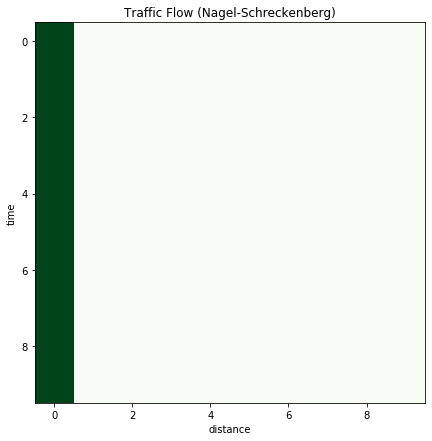

In [68]:
trimmed = traffic_flow(N = 10, ncars = 1, nspots = 10, v_max = 2, p = 0.99, burn = False, uniform = False, )

## Many Cars

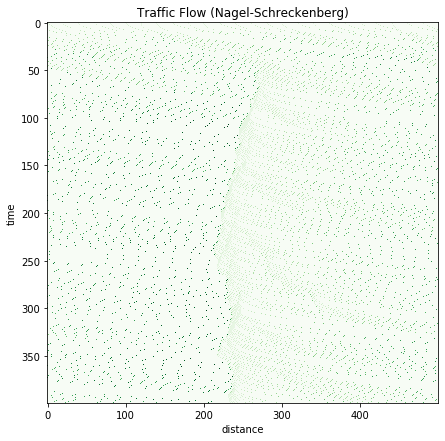

In [69]:
trimmed, speeds, cars = traffic_flow(ncars=25,nspots=500,v_max=25,p=0.33,uniform=True,N=400,burn=False)

In [70]:
car_pos_map = pd.DataFrame(cars).reset_index().melt(id_vars='index', value_name='car', var_name='position')

traffic = pd.DataFrame(trimmed).reset_index().melt(id_vars='index', value_name='radians', var_name='position')
speeds = pd.DataFrame(speeds).reset_index().melt(id_vars='index', value_name='speed', var_name='position')
traffic['x'] = np.sin(traffic.radians)
traffic['y'] = np.cos(traffic.radians)

traffic = pd.merge(traffic,speeds, on=['index','position'])
traffic = pd.merge(traffic,car_pos_map, on=['index','position'])

traffic['point_size'] = 3 # traffic['speed'] + 1

In [71]:
traffic_fig = px.scatter(traffic, x='x', y='y', title='Traffic!?', text='car', color='speed', color_continuous_scale='rdylgn', color_continuous_midpoint=traffic.speed.max()/2, size='point_size', animation_group='car', animation_frame='index', range_x=[-1.1,1.1], range_y=[-1.1,1.1])

In [72]:
circles = [go.layout.Shape(
            type="circle",
            xref="x",
            yref="y",
            x0=-1.125,
            y0=-1.125,
            x1=1.125,
            y1=1.125,
            opacity=0.4,
            #fillcolor="black",
            line_color="black",
            line=go.layout.shape.Line(
                width = 10            
            )

    ),
           go.layout.Shape(
            type="circle",
            xref="x",
            yref="y",
            x0=-0.85,
            y0=-0.85,
            x1=0.85,
            y1=0.85,
            opacity=0.4,
            line_color="black",
            line=go.layout.shape.Line(
                width = 10                
            )
    )
]

In [73]:
traffic_fig.update_layout(shapes=circles)

# Toy Model Again

In general, toy models like we saw before are scaled up to include more parameters, to:

* Calibrate to [**Market Data**](#What-Historical-Data-do-we-use?) (historical prices, indexes, interest rates, the sentiments of Donald Trump's tweets, ...)
* Calculate [**Greeks**](#Greeks) (effects of small changes on input params)
* More accurately hedge risk

Plotting Monte Carlo runs allows easy visualisation of the effect of changes in parameters

## Toy Disclaimer for the Toy Model

Please don't blame me if you lose all your money using this toy model.

### What Historical Data do we use?

Consider **TD Bank** Stocks. We can look at three time periods that produce very different results

1. Lots of History (1999-) 
2. Recent History (2018-)
3. Last Quarter (2019 Q1)

Last Twenty Years

In [74]:
td = get_history('TD.TO')

In [75]:
last_twenty, mean, vol = slice_history(td, start='2000-01-04')
twenty_plot = plot_runs(50, mean, vol, last_twenty, title='Lots of History', quantiles=True, extend=10*261)

Last Year

In [76]:
last_year, mean, vol = slice_history(td,'2018-08-02')
year_plot = plot_runs(50, mean, vol, last_year, title='Last Year', quantiles=True, extend=10*261)

Last Quarter

In [77]:
q1, mean, vol = slice_history(td,'2019-01-01','2019-05-01')
quarter_plots = plot_runs(50, mean, vol, q1, title='Q1', quantiles=True, extend=10*261)

In [78]:
from collections import OrderedDict

from plotly.subplots import make_subplots

def combine_figs(figs_dict, title=''):
    # provide dict with names as keys and figures as values
    # returns subplots with figs as rows

    runs_compare = make_subplots(rows=len(figs_dict),row_titles=list(figs_dict.keys())[::-1], shared_xaxes=True)

    for i, fig in enumerate(figs_dict.values()):
        traces = fig.data
        n = len(traces)
        runs_compare.add_traces(traces, [i+1]*n, [1]*n)
        
    runs_compare.layout.title = title        
    return runs_compare

figs = OrderedDict({
    'Twenty Years':twenty_plot,
    'Last Year': year_plot,
    'Q1': quarter_plots
})

Comparing Input Data

In [80]:
combine_figs(figs, title='Historical Data Matters')

## Greeks

A set of derivatives which describe how option values change with changes in market data. The big three first-order derivatives are:

- $\Delta$ Delta - Sensitivity to **underlying price**
    - We can get an idea of this by shifting our mean and re-running the Monte Carlo
- $\nu$ Vega - Sensitivity to **volatility**
    - We can get an idea of this by shifting our volatility and re-running the Monte Carlo
- $\Theta$ Theta - Sensitivity to **time**
    - We already have an idea of this from our time evolution of the underlying
    

There are also a large potato sack's worth of other first, second and third-order derivatives (derivatives of derivatives of derivatives!) that you could go a lifetime not thinking about

In [81]:
def shocks(df, mean, vol, extend=0, N=50, vega=1, delta=0):
    # Vega/Delta shock on monte carlo runs
    # Delta (bps) is added to the mean, vega multiplied straight against vol
    if not (vega or delta):
        return
    figs = OrderedDict({
        'Up': plot_runs(N, mean*(1+delta*0.01*0.01), vol*vega, df, extend, quantiles=True),
        'Stable': plot_runs(N, mean, vol, df, extend, quantiles=True),
        'Down': plot_runs(N, mean*(1-delta*0.01*0.01), vol/min(vega,1), df, extend, quantiles=True),
    })
    title = f'{"Vega " if vega > 1 else ""}{"Delta " if delta else ""}Shock'
    return combine_figs(figs, title=title)

### Delta

In [82]:
last_year, mean, vol = slice_history(td,'2018-08-02')
shocks(last_year, mean, vol, extend=10*261, delta=1)

### Vega

In [84]:
shocks(last_year, mean, vol, extend=10*261, vega=3)

# The Power of Monte Carlo

- Replacing uncertain variables with probability distributions, models can account for inherent uncertainty

- By sampling probability distributions, we explore possible outcomes and account for risk within the model 

- Possible to find results for problems where no analytic (or elegant) solutions are known

## Questions ... ?